# FastAI with cropped images

In [1]:
import os
import random
from pathlib import Path

import fastai
import matplotlib.pyplot as plt
import torch
import torchvision
from fastai.callbacks.hooks import hook_output
from fastai.vision import *
from fastai.widgets import *
from flashtorch.saliency import Backprop
from flashtorch.utils import (apply_transforms, denormalize,
                              format_for_plotting, load_image,
                              standardize_and_clip)
from scipy.spatial.distance import cosine
from sklearn.neighbors import KNeighborsClassifier
from torchvision import transforms

In [2]:
fastai.device = torch.device('cuda')

## Get the data and build the model

In [2]:
data = ImageDataBunch.from_folder('/home/mauto/data/LincParse/cv_dataset_zoom', ds_tfms=get_transforms(), size=224).normalize(imagenet_stats)

In [5]:
data.train_ds.y.classes

['100',
 '101',
 '102',
 '103',
 '115',
 '116',
 '117',
 '120',
 '121',
 '122',
 '123',
 '124',
 '125',
 '127',
 '131',
 '133',
 '139',
 '140',
 '141',
 '142',
 '143',
 '147',
 '15',
 '155',
 '158',
 '159',
 '16',
 '167',
 '17',
 '173',
 '183',
 '184',
 '185',
 '189',
 '19',
 '196',
 '197',
 '198',
 '199',
 '203',
 '204',
 '205',
 '206',
 '21',
 '212',
 '237',
 '238',
 '239',
 '241',
 '242',
 '243',
 '244',
 '245',
 '247',
 '248',
 '249',
 '250',
 '260',
 '261',
 '268',
 '269',
 '27',
 '270',
 '271',
 '284',
 '285',
 '29',
 '297',
 '298',
 '299',
 '30',
 '300',
 '31',
 '311',
 '32',
 '320',
 '321',
 '322',
 '33',
 '330',
 '334',
 '34',
 '35',
 '351',
 '352',
 '353',
 '354',
 '355',
 '356',
 '36',
 '366',
 '37',
 '372',
 '373',
 '374',
 '375',
 '376',
 '377',
 '378',
 '379',
 '38',
 '39',
 '40',
 '401',
 '403',
 '404',
 '407',
 '409',
 '41',
 '415',
 '416',
 '419',
 '42',
 '420',
 '429',
 '431',
 '432',
 '433',
 '434',
 '436',
 '437',
 '439',
 '44',
 '440',
 '442',
 '451',
 '452',
 '455

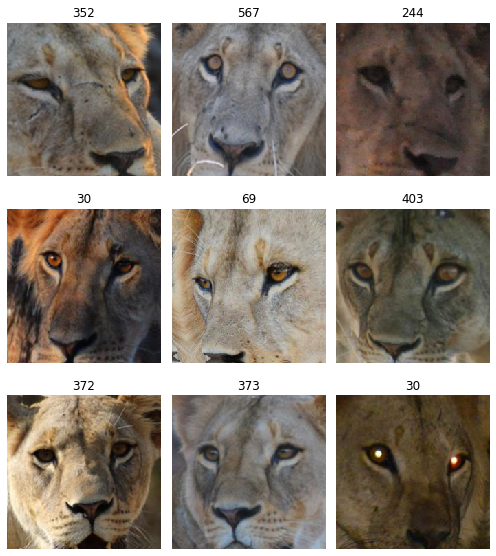

In [4]:
data.show_batch(rows=3, figsize=(7,8))

In [5]:
data.c, len(data.train_ds), len(data.valid_ds)

(180, 4365, 866)

In [6]:
learn = cnn_learner(data, models.resnet50, metrics=[accuracy, top_k_accuracy])

In [12]:
learn.data.train_ds.y.classes

['100',
 '101',
 '102',
 '103',
 '115',
 '116',
 '117',
 '120',
 '121',
 '122',
 '123',
 '124',
 '125',
 '127',
 '131',
 '133',
 '139',
 '140',
 '141',
 '142',
 '143',
 '147',
 '15',
 '155',
 '158',
 '159',
 '16',
 '167',
 '17',
 '173',
 '183',
 '184',
 '185',
 '189',
 '19',
 '196',
 '197',
 '198',
 '199',
 '203',
 '204',
 '205',
 '206',
 '21',
 '212',
 '237',
 '238',
 '239',
 '241',
 '242',
 '243',
 '244',
 '245',
 '247',
 '248',
 '249',
 '250',
 '260',
 '261',
 '268',
 '269',
 '27',
 '270',
 '271',
 '284',
 '285',
 '29',
 '297',
 '298',
 '299',
 '30',
 '300',
 '31',
 '311',
 '32',
 '320',
 '321',
 '322',
 '33',
 '330',
 '334',
 '34',
 '35',
 '351',
 '352',
 '353',
 '354',
 '355',
 '356',
 '36',
 '366',
 '37',
 '372',
 '373',
 '374',
 '375',
 '376',
 '377',
 '378',
 '379',
 '38',
 '39',
 '40',
 '401',
 '403',
 '404',
 '407',
 '409',
 '41',
 '415',
 '416',
 '419',
 '42',
 '420',
 '429',
 '431',
 '432',
 '433',
 '434',
 '436',
 '437',
 '439',
 '44',
 '440',
 '442',
 '451',
 '452',
 '455

## Train last layers

In [7]:
learn.fit_one_cycle(10)

epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,5.689068,3.560745,0.277136,0.491917,00:21
1,3.863604,2.345259,0.489607,0.697460,00:18
2,2.839701,1.795385,0.579677,0.781755,00:18
3,2.069094,1.451269,0.665127,0.837182,00:18
4,1.552364,1.215873,0.711316,0.876443,00:18
5,1.182087,1.084113,0.741340,0.896074,00:18
6,0.920173,0.949654,0.762125,0.899538,00:18
7,0.702539,0.895831,0.782910,0.911085,00:18
8,0.575924,0.870103,0.782910,0.919169,00:18
9,0.501416,0.871852,0.784065,0.913395,00:18


In [9]:
learn.save('stage-1')

In [13]:
learn.load('stage-1')

Learner(data=ImageDataBunch;

Train: LabelList (4365 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
401,401,401,401,401
Path: /home/mauto/data/LincParse/cv_dataset_filtered_same;

Valid: LabelList (866 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
401,401,401,401,401
Path: /home/mauto/data/LincParse/cv_dataset_filtered_same;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps

## Train all model

In [8]:
learn.unfreeze()

In [11]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


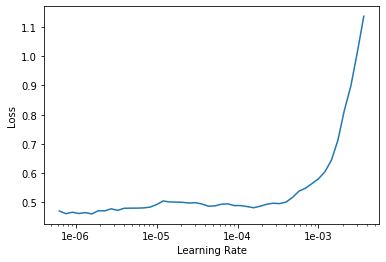

In [12]:
learn.recorder.plot()

In [9]:
learn.fit_one_cycle(20)

epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,0.479298,0.852526,0.797921,0.915704,00:25
1,0.438999,0.795699,0.815242,0.929561,00:24
2,0.562434,0.937132,0.774827,0.928406,00:24
3,0.704685,1.008205,0.766744,0.919169,00:24
4,0.743781,1.249040,0.725173,0.890300,00:24
5,0.684528,0.953293,0.771363,0.920323,00:24
6,0.579348,0.722161,0.822171,0.945727,00:24
7,0.403289,0.600174,0.859122,0.961894,00:24
8,0.331001,0.778314,0.810624,0.936490,00:25
9,0.271908,0.479913,0.882217,0.963049,00:24


## Analyze results

In [14]:
interp = ClassificationInterpretation.from_learner(learn)

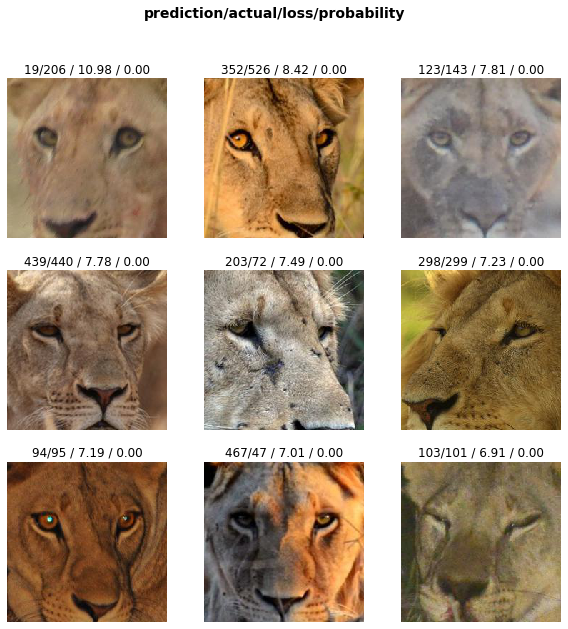

In [15]:
interp.plot_top_losses(9, figsize=(10,10))

In [16]:
interp.most_confused(min_val=2)

[('351', '352', 3)]

In [17]:
learn.save('stage-2')

In [5]:
learn.load('stage-2')

Learner(data=ImageDataBunch;

Train: LabelList (4365 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
401,401,401,401,401
Path: /home/mauto/data/LincParse/cv_dataset_zoom;

Valid: LabelList (866 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
401,401,401,401,401
Path: /home/mauto/data/LincParse/cv_dataset_zoom;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0

## Save model

In [17]:
learn.export('more_epochs.pkl')

In [ ]:
learner = load_learner('/home/mauto/data/LincParse/cv_dataset_zoom')

## Saliency maps

In [60]:
backprop = Backprop(learn.model)

In [61]:
sample = learn.data.train_ds[800]

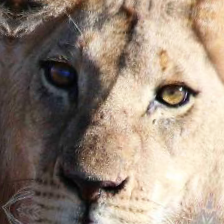

In [62]:
sample[0]

In [63]:
sample[1]

Category 592

In [64]:
pred = learn.predict(sample[0])

In [65]:
input_ = sample[0].data.unsqueeze_(0)
input_.requires_grad = True

In [66]:
gradients = backprop.calculate_gradients(input_.cuda(), pred[1].cuda(), use_gpu=True)

/home/mauto/.local/share/virtualenvs/linc-venv/lib/python3.6/site-packages/flashtorch/saliency/backprop.py:111: UserWarning: The predicted class index 13 does notequal the target class index 153. Calculatingthe gradient w.r.t. the predicted class.
  'the gradient w.r.t. the predicted class.'


In [67]:
max_gradients = backprop.calculate_gradients(input_.cuda(), pred[1].cuda(), take_max=True, use_gpu=True)

In [68]:
def visualize(input_, gradients, max_gradients):
    subplots = [
    # (title, [(image1, cmap, alpha), (image2, cmap, alpha)])
    ('Input image', [(format_for_plotting(denormalize(input_)), None, None)]),
    ('Gradients across RGB channels',[(format_for_plotting(standardize_and_clip(gradients)), None, None)]),
    ('Max gradients', [(format_for_plotting(standardize_and_clip(max_gradients)), 'viridis', None)]),
    ('Overlay', [(format_for_plotting(denormalize(input_)), None, None), (format_for_plotting(standardize_and_clip(max_gradients)), 'viridis', .5)])
    ]

    fig = plt.figure(figsize=(16, 4))

    for i, (title, images) in enumerate(subplots):
        ax = fig.add_subplot(1, len(subplots), i + 1)
        ax.set_axis_off()
        ax.set_title(title)

        for image, cmap, alpha in images:
            ax.imshow(image, cmap=cmap, alpha=alpha)

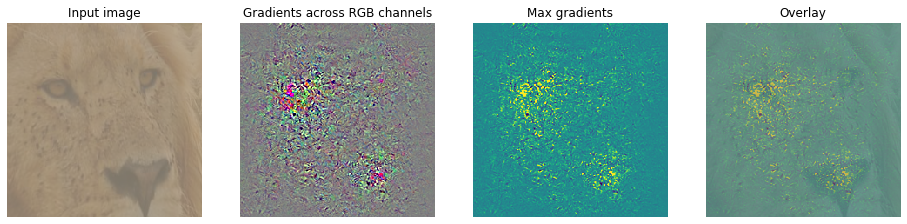

In [27]:
visualize(input_ ,gradients, max_gradients)

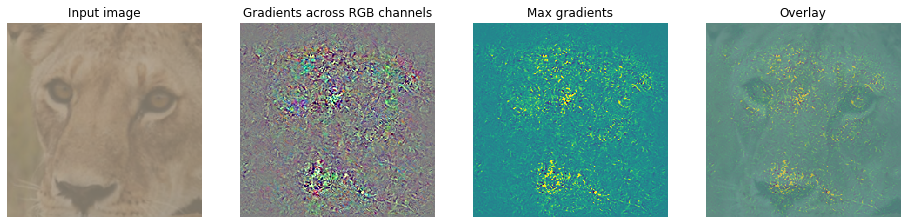

In [44]:
visualize(input_ ,gradients, max_gradients)

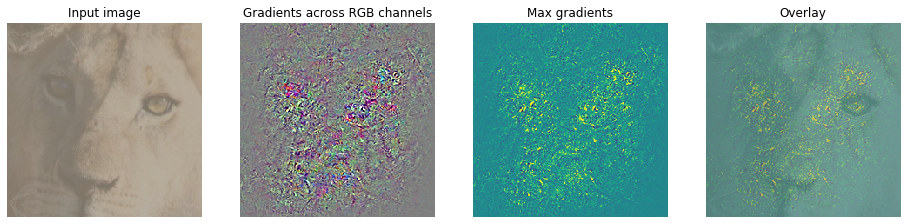

In [69]:
visualize(input_ ,gradients, max_gradients)

## Plotting matching scores

In [72]:
def imshow(img,text=None,should_save=False):
    npimg = img.numpy()
    plt.axis("off")
    if text:
        plt.text(75, 8, text, style='italic',fontweight='bold',
            bbox={'facecolor':'white', 'alpha':0.8, 'pad':10})
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()  

In [73]:
def print_pair(pair,tfms,learn,cos,emb_layer):
    (img1,img2) = pair
    img1 = open_image(img1)
    img2 = open_image(img2)
    img1 = img1.apply_tfms(tfms[0], size=224)
    img2 = img2.apply_tfms(tfms[0], size=224)
    concatenated = torch.cat((img1.data.unsqueeze(0),img2.data.unsqueeze(0)),0)
    hook = hook_output(emb_layer)
    pred1 = learn.predict(img1)
    emb1 = hook.stored
    pred2 = learn.predict(img2)
    emb2 = hook.stored
    hook.remove()
    score_l2 = torch.dist(emb1[0],emb2[0])
    score_cos = cos(emb1,emb2)
    imshow(torchvision.utils.make_grid(concatenated),"Score norm: {:.2f}, Score cos: {:.2f}".format(score_l2, score_cos[0]))

SAME


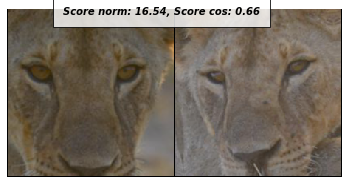

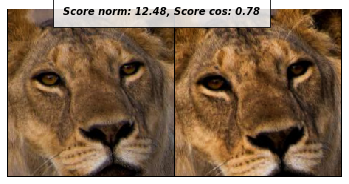

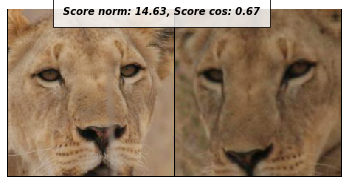

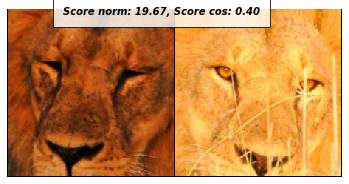

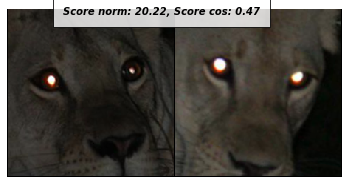

...

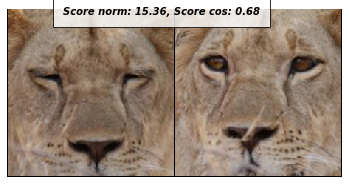

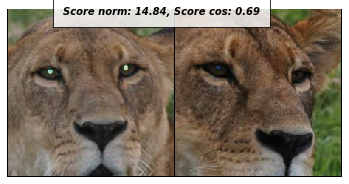

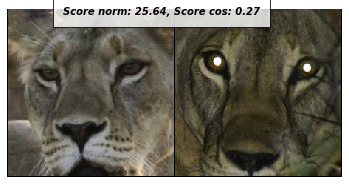

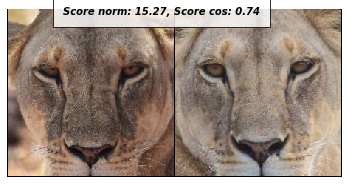

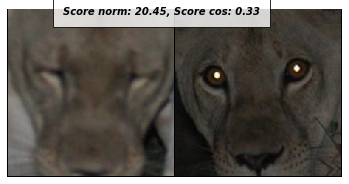

DIFF


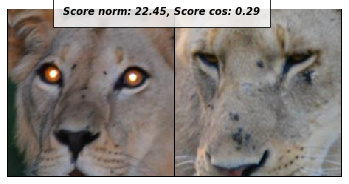

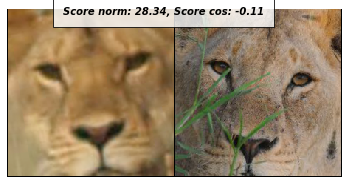

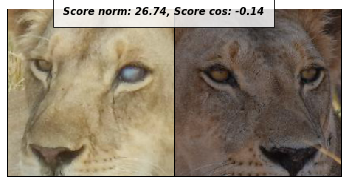

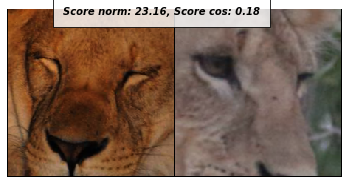

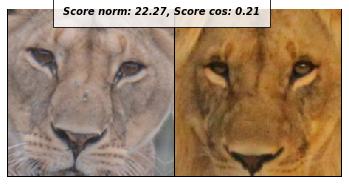

...

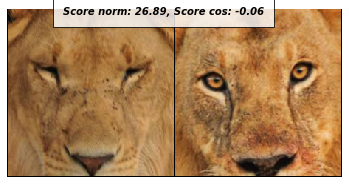

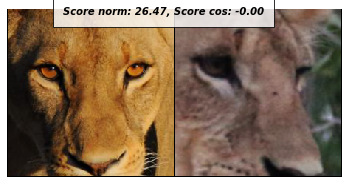

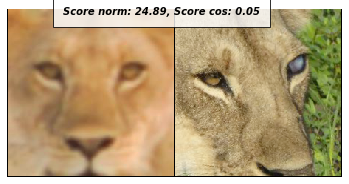

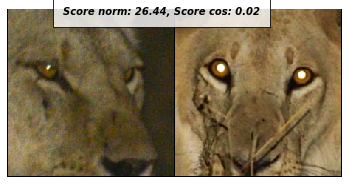

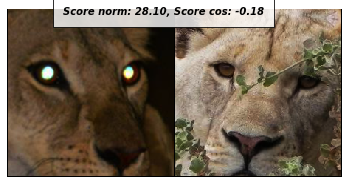

In [74]:
dataset_root = Path("/home/mauto/data/LincParse/cv_dataset_zoom")
val_root = dataset_root / "not_used/train"
num = 20

matches = []
for lion_dir in val_root.iterdir():
    lion_imgs = list(lion_dir.iterdir())
    for i, img1 in enumerate(lion_imgs):
        i += 1
        if i < len(lion_imgs):
            for img2 in lion_imgs[i:]:
                matches.append((img1, img2))

miss_matches = set()
images = list(val_root.glob("*/*.jpg"))
while len(miss_matches) < num:
    img1 = random.choice(images)
    img2 = random.choice(images)
    if img1 != img2:
        miss_matches.add((img1, img2))
        
emb_layer = list(learn.model.modules())[-3]
cos = torch.nn.CosineSimilarity()
tfms = get_transforms(max_warp=0)
random.shuffle(matches)
print("SAME")
for pair in matches[:num]:
    print_pair(pair,tfms,learn,cos,emb_layer)

print("DIFF")
for pair in miss_matches:
    print_pair(pair,tfms,learn,cos,emb_layer)


## Get identification scores

In [11]:
not_used = (ImageList.from_folder(dataset_root/'not_used')
    .split_by_folder()          
    .label_from_folder()
    .transform(None, size=224)
    .databunch()
    .normalize(imagenet_stats))

In [12]:
fix_train = not_used.train_dl.new(shuffle=False, drop_last=False)
fix_valid = not_used.valid_dl.new(shuffle=False, drop_last=False)

In [13]:
def get_embeddings(cls, learn, dl_train, dl_valid,**kwargs):
    hook = hook_output(list(learn.model.modules())[-3])

    train_actns = cls.get_actns(learn, hook=hook, dl=dl_train, **kwargs)
    valid_actns = cls.get_actns(learn, hook=hook, dl=dl_valid, **kwargs)
    
    hook.remove()

    return train_actns, valid_actns

In [14]:
emb_gal, emb_probes = get_embeddings(DatasetFormatter, learn, fix_train, fix_valid, pool=None)

Getting activations...


Getting activations...


In [15]:
def identification_score(emb_gal, label_gal, emb_probes, label_probes):
    knn_classifier_l2 = KNeighborsClassifier(n_neighbors=5, n_jobs=-1)
    knn_classifier_cosine = KNeighborsClassifier(n_neighbors=5, metric=cosine, n_jobs=-1)

    knn_classifier_l2.fit(emb_gal, label_gal)
    knn_classifier_cosine.fit(emb_gal, label_gal)

    top1_acc_l2 = knn_classifier_l2.score(emb_probes, label_probes)
    top1_acc_cos = knn_classifier_cosine.score(emb_probes, label_probes)

    l2_neighbors = knn_classifier_l2.kneighbors(emb_probes, n_neighbors=5, return_distance=False)
    cos_neighbors = knn_classifier_cosine.kneighbors(
        emb_probes, n_neighbors=5, return_distance=False
    )

    top5_acc_l2 = 0
    top5_acc_cos = 0

    for i in range(len(l2_neighbors)):
        top5_acc_l2 += 1 if label_probes[i] in label_gal[l2_neighbors[i]] else 0
        top5_acc_cos += 1 if label_probes[i] in label_gal[cos_neighbors[i]] else 0

    top5_acc_l2 = top5_acc_l2 / len(l2_neighbors)
    top5_acc_cos = top5_acc_cos / len(l2_neighbors)

    return top1_acc_l2, top5_acc_l2, top1_acc_cos, top5_acc_cos

In [88]:
identification_score(emb_gal, not_used.train_ds.y.items, emb_probes, not_used.valid_ds.y.items)

(0.717948717948718, 0.9358974358974359, 0.7051282051282052, 0.9230769230769231)

In [16]:
identification_score(emb_gal, not_used.train_ds.y.items, emb_probes, not_used.valid_ds.y.items)

(0.7243589743589743,
 0.9166666666666666,
 0.7051282051282052,
 0.9230769230769231)

## Plot most similar images

In [75]:
def plot_most_similar(img_probes, emb_probes, label_probes, img_gal, emb_gal, label_gal, k):
    knn_classifier_l2 = KNeighborsClassifier(n_neighbors=5, n_jobs=-1)
    knn_classifier_cosine = KNeighborsClassifier(n_neighbors=5, metric=cosine, n_jobs=-1)

    knn_classifier_l2.fit(emb_gal, label_gal)
    knn_classifier_cosine.fit(emb_gal, label_gal)

    l2_neighbors = knn_classifier_l2.kneighbors(emb_probes, n_neighbors=k, return_distance=False)
    cos_neighbors = knn_classifier_cosine.kneighbors(
        emb_probes, n_neighbors=k, return_distance=False
    )

    for i,img_probe in enumerate(img_probes):
        fig, ax = plt.subplots(ncols=k + 1, figsize=[15, (k + 1) * 15])
        ax[0].imshow(transforms.ToPILImage()(img_probe.data))
        ax[0].title.set_text('Original - {}'.format(label_probes[i]))
        for j, img in enumerate(img_gal[l2_neighbors[i]]):
            ax[j + 1].imshow(transforms.ToPILImage()(img.data))
            if label_probes[i] == label_gal[l2_neighbors[i]][j]:
                ax[j + 1].title.set_text('Correct - {}'.format(label_gal[l2_neighbors[i]][j]))
            else:
                ax[j + 1].title.set_text('Wrong - {}'.format(label_gal[l2_neighbors[i]][j]))
        plt.tight_layout()
        plt.show()
        plt.close(fig)

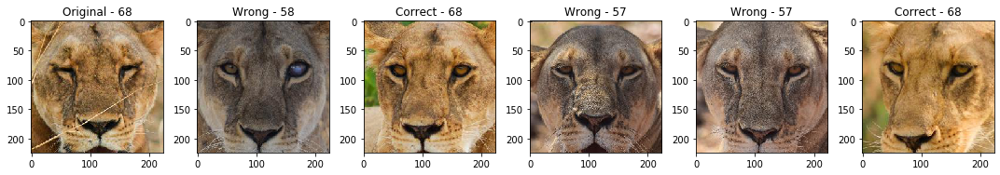

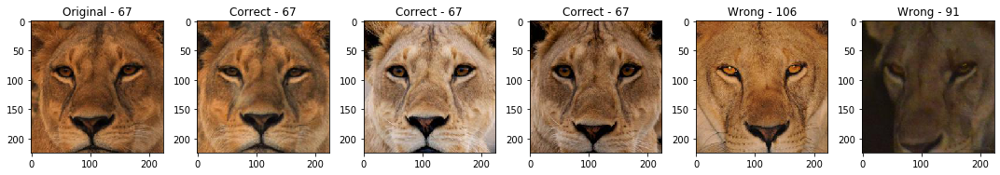

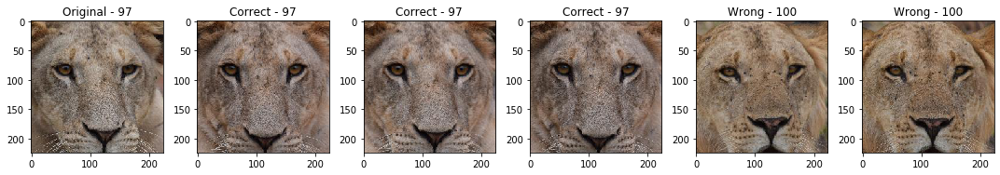

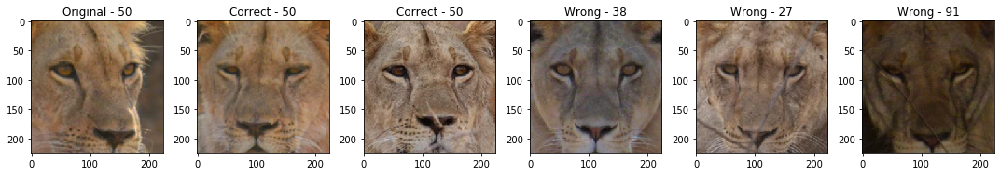

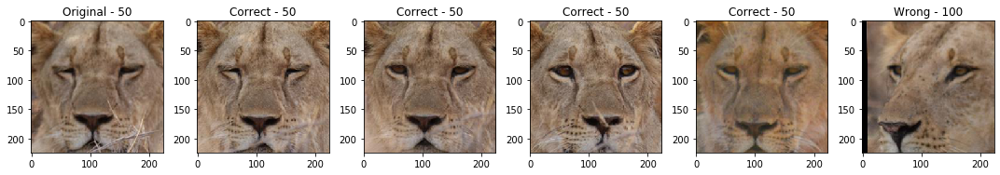

...

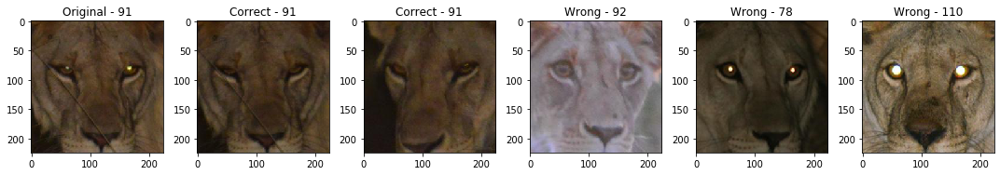

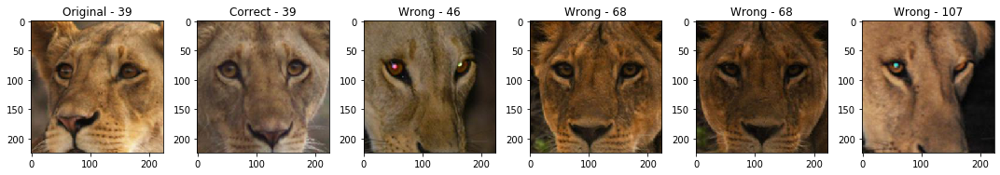

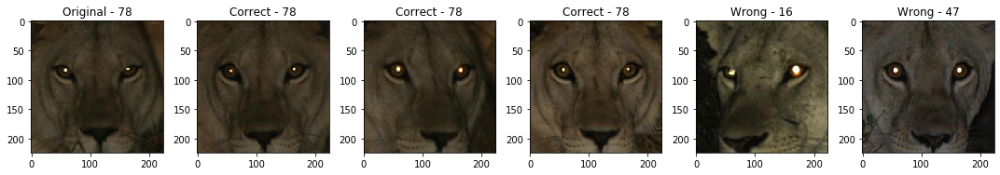

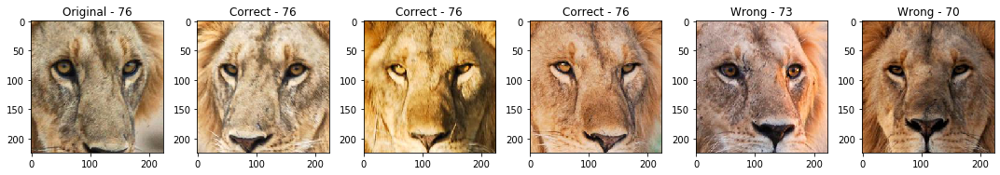

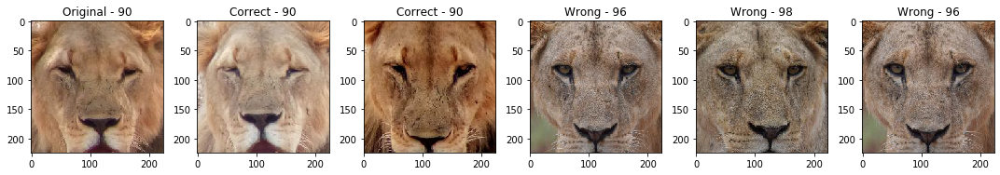

KeyboardInterrupt: 

In [76]:
plot_most_similar(not_used.valid_ds.x, emb_probes, not_used.valid_ds.y.items, not_used.train_ds.x, emb_gal, not_used.train_ds.y.items, 5)